In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')



In [2]:
df=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


The output of the dataset is "yes" or "no" hence we will apply the Logistic regression for the given dataset

In [3]:
df.shape

(8425, 23)

In [4]:
df.ndim

2

In [5]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [6]:
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [7]:
df.min()

Date             2008-12-01
Location           Adelaide
MinTemp                -2.0
MaxTemp                 8.2
Rainfall                0.0
Evaporation             0.0
Sunshine                0.0
WindGustSpeed           7.0
WindSpeed9am            0.0
WindSpeed3pm            0.0
Humidity9am            10.0
Humidity3pm             6.0
Pressure9am           989.8
Pressure3pm           982.9
Cloud9am                0.0
Cloud3pm                0.0
Temp9am                 1.9
Temp3pm                 7.3
dtype: object

In [8]:
df.max()

Date             2017-06-25
Location         Wollongong
MinTemp                28.5
MaxTemp                45.5
Rainfall              371.0
Evaporation           145.0
Sunshine               13.9
WindGustSpeed         107.0
WindSpeed9am           63.0
WindSpeed3pm           83.0
Humidity9am           100.0
Humidity3pm            99.0
Pressure9am          1039.0
Pressure3pm          1036.0
Cloud9am                8.0
Cloud3pm                8.0
Temp9am                39.4
Temp3pm                44.1
dtype: object

In [9]:
df.nunique()

Date             3004
Location           12
MinTemp           285
MaxTemp           331
Rainfall          250
Evaporation       116
Sunshine          140
WindGustDir        16
WindGustSpeed      52
WindDir9am         16
WindDir3pm         16
WindSpeed9am       34
WindSpeed3pm       35
Humidity9am        90
Humidity3pm        94
Pressure9am       384
Pressure3pm       374
Cloud9am            9
Cloud3pm            9
Temp9am           304
Temp3pm           328
RainToday           2
RainTomorrow        2
dtype: int64

In [10]:
df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

<AxesSubplot:>

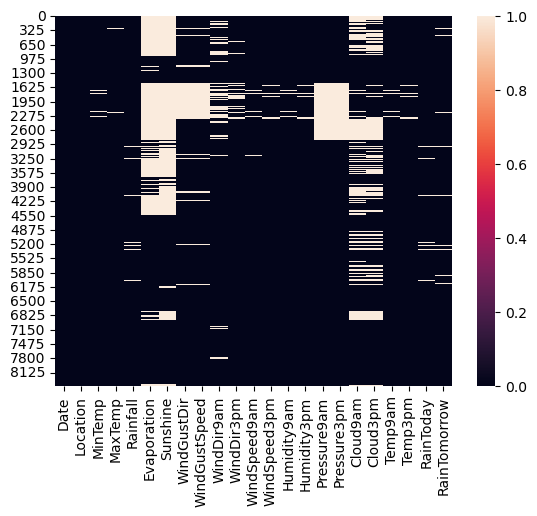

In [11]:
sns.heatmap(df.isnull())

In [12]:
df.dropna(inplace =True)
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,CoffsHarbour,19.8,27.1,24.4,8.6,9.0,ESE,35.0,SW,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,Yes,Yes
908,2009-03-11,CoffsHarbour,18.7,25.6,6.8,3.8,3.4,E,33.0,SW,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,Yes,Yes
909,2009-03-12,CoffsHarbour,16.5,25.5,16.8,2.8,6.1,WSW,19.0,WSW,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,Yes,No
910,2009-03-13,CoffsHarbour,18.5,26.9,0.0,3.2,11.0,ENE,30.0,SW,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,No,No
911,2009-03-14,CoffsHarbour,18.2,28.2,0.0,6.8,9.0,NNE,50.0,NNW,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,No,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,Darwin,25.2,34.5,3.0,4.0,9.2,NNE,39.0,N,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,Yes,No
8382,2012-11-07,Darwin,26.2,33.3,0.0,6.0,5.9,N,54.0,ENE,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,No,Yes
8383,2012-11-08,Darwin,24.9,32.8,20.4,6.2,8.7,WNW,37.0,NNE,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,Yes,No
8384,2012-11-09,Darwin,25.5,33.1,0.0,4.8,7.1,SSE,37.0,E,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,No,No


In [13]:
df.Location.value_counts()

PerthAirport    1159
Melbourne       1126
CoffsHarbour     552
Brisbane         524
Darwin           249
Williamtown      180
Name: Location, dtype: int64

PerthAirport    1159
Melbourne       1126
CoffsHarbour     552
Brisbane         524
Darwin           249
Williamtown      180
Name: Location, dtype: int64


<AxesSubplot:xlabel='Location', ylabel='count'>

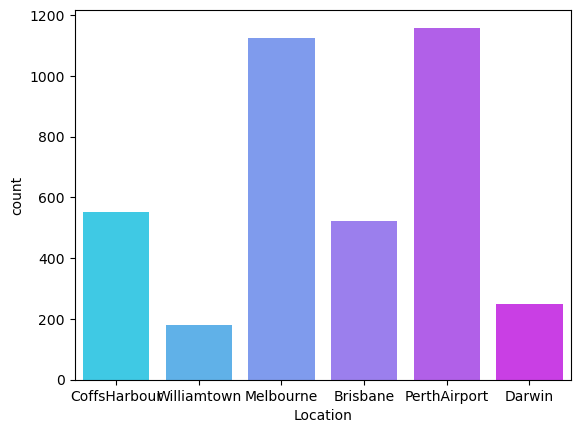

In [14]:
print(df['Location'].value_counts())
sns.countplot(df['Location'], palette='cool')

<AxesSubplot:>

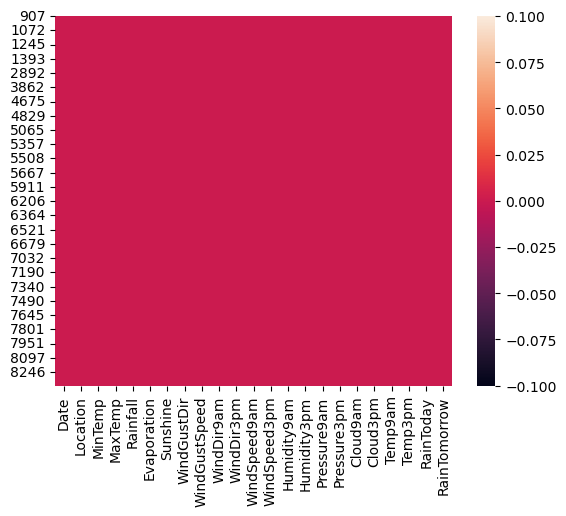

In [15]:
sns.heatmap(df.isnull())

In [16]:
from sklearn.preprocessing import LabelEncoder

In [17]:
le=LabelEncoder()

In [18]:
df['Location']=le.fit_transform(df['Location'])

In [19]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,ESE,35.0,SW,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,Yes,Yes
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,E,33.0,SW,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,Yes,Yes
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,WSW,19.0,WSW,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,Yes,No
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,ENE,30.0,SW,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,No,No
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,NNE,50.0,NNW,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,No,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,NNE,39.0,N,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,Yes,No
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,N,54.0,ENE,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,No,Yes
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,WNW,37.0,NNE,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,Yes,No
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,SSE,37.0,E,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,No,No


In [20]:
df.drop(['Date'], axis=1)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,1,19.8,27.1,24.4,8.6,9.0,ESE,35.0,SW,ESE,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,Yes,Yes
908,1,18.7,25.6,6.8,3.8,3.4,E,33.0,SW,S,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,Yes,Yes
909,1,16.5,25.5,16.8,2.8,6.1,WSW,19.0,WSW,ESE,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,Yes,No
910,1,18.5,26.9,0.0,3.2,11.0,ENE,30.0,SW,ENE,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,No,No
911,1,18.2,28.2,0.0,6.8,9.0,NNE,50.0,NNW,NE,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,No,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2,25.2,34.5,3.0,4.0,9.2,NNE,39.0,N,NNE,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,Yes,No
8382,2,26.2,33.3,0.0,6.0,5.9,N,54.0,ENE,E,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,No,Yes
8383,2,24.9,32.8,20.4,6.2,8.7,WNW,37.0,NNE,NW,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,Yes,No
8384,2,25.5,33.1,0.0,4.8,7.1,SSE,37.0,E,WSW,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,No,No


In [21]:
df.dtypes

Date              object
Location           int32
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [22]:
df.WindGustDir.value_counts()

N      449
E      408
SW     382
WSW    306
S      298
SSE    232
SSW    223
ENE    221
W      210
SE     195
NNE    185
ESE    176
NE     153
NW     125
WNW    119
NNW    108
Name: WindGustDir, dtype: int64

N      449
E      408
SW     382
WSW    306
S      298
SSE    232
SSW    223
ENE    221
W      210
SE     195
NNE    185
ESE    176
NE     153
NW     125
WNW    119
NNW    108
Name: WindGustDir, dtype: int64


<AxesSubplot:xlabel='WindGustDir', ylabel='count'>

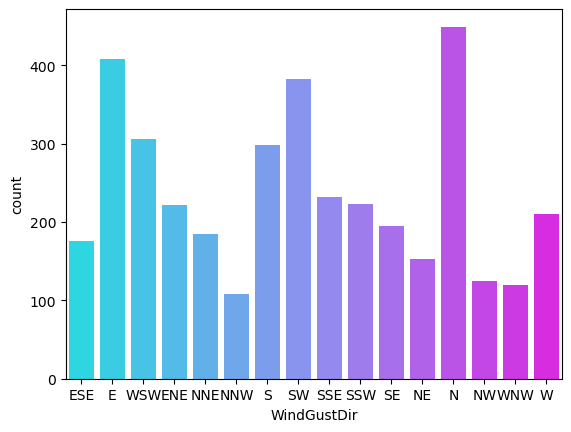

In [23]:
print(df['WindGustDir'].value_counts())
sns.countplot(df['WindGustDir'],palette='cool')

In [24]:
df['WindGustDir']=le.fit_transform(df['WindGustDir'])

In [25]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,SW,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,Yes,Yes
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,SW,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,Yes,Yes
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,WSW,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,Yes,No
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,SW,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,No,No
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,NNW,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,No,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,N,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,Yes,No
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,ENE,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,No,Yes
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,NNE,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,Yes,No
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,E,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,No,No


In [26]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [27]:
df.dtypes

Date              object
Location           int32
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir        int32
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [28]:
df.WindDir9am.value_counts()

N      547
SW     448
ENE    300
WSW    291
SSW    254
NNE    238
E      232
W      225
SE     192
NE     188
S      179
SSE    166
NW     140
WNW    137
NNW    134
ESE    119
Name: WindDir9am, dtype: int64

N      547
SW     448
ENE    300
WSW    291
SSW    254
NNE    238
E      232
W      225
SE     192
NE     188
S      179
SSE    166
NW     140
WNW    137
NNW    134
ESE    119
Name: WindDir9am, dtype: int64


<AxesSubplot:xlabel='WindDir9am', ylabel='count'>

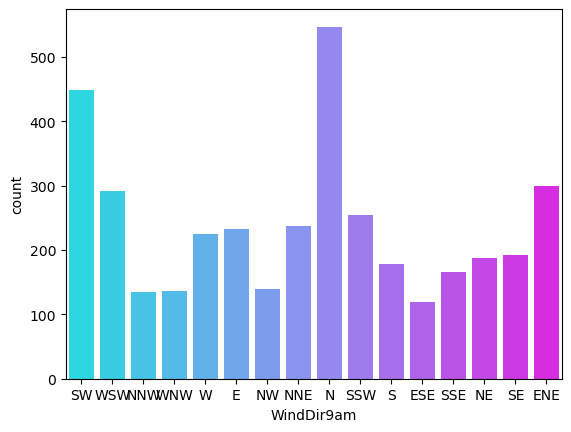

In [29]:
print(df['WindDir9am'].value_counts())
sns.countplot(df['WindDir9am'],palette='cool')

In [30]:
df['WindDir9am']=le.fit_transform(df['WindDir9am'])

In [31]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,Yes,Yes
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,Yes,Yes
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,Yes,No
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,No,No
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,No,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,Yes,No
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,No,Yes
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,Yes,No
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,No,No


In [32]:
df.WindDir3pm.value_counts()

S      406
WSW    336
N      288
SW     284
SSE    283
E      258
W      226
SE     222
ESE    216
ENE    216
NE     213
NNE    197
SSW    187
WNW    161
NNW    157
NW     140
Name: WindDir3pm, dtype: int64

S      406
WSW    336
N      288
SW     284
SSE    283
E      258
W      226
SE     222
ESE    216
ENE    216
NE     213
NNE    197
SSW    187
WNW    161
NNW    157
NW     140
Name: WindDir3pm, dtype: int64


<AxesSubplot:xlabel='WindDir3pm', ylabel='count'>

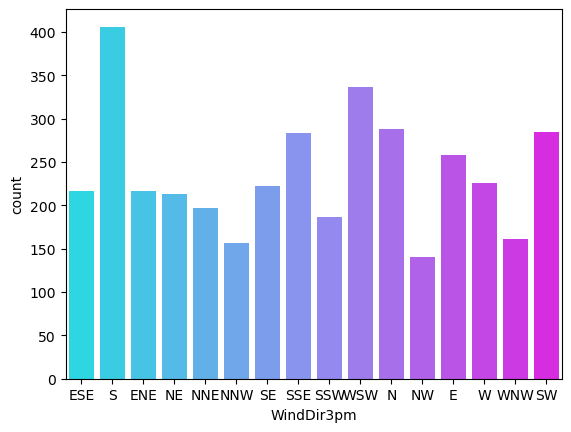

In [33]:
print(df['WindDir3pm'].value_counts())
sns.countplot(df['WindDir3pm'],palette='cool')

In [34]:
df['WindDir3pm']=le.fit_transform(df['WindDir3pm'])

In [35]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,Yes,Yes
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,Yes,Yes
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,Yes,No
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,No,No
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,No,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,Yes,No
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,No,Yes
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,Yes,No
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,No,No


In [36]:
df.dtypes

Date              object
Location           int32
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir        int32
WindGustSpeed    float64
WindDir9am         int32
WindDir3pm         int32
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [37]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [38]:
df.RainToday.value_counts()

No     2901
Yes     889
Name: RainToday, dtype: int64

No     2901
Yes     889
Name: RainToday, dtype: int64


<AxesSubplot:xlabel='RainToday', ylabel='count'>

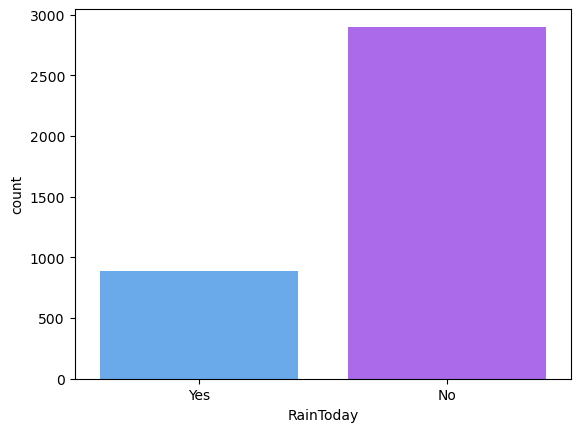

In [39]:
print(df['RainToday'].value_counts())
sns.countplot(df['RainToday'],palette='cool')

In [40]:
df['RainToday']=le.fit_transform(df['RainToday'])

In [41]:
df


,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1,Yes
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1,Yes
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1,No
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0,No
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1,No
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0,Yes
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1,No
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0,No


In [42]:
df.RainTomorrow.value_counts()

No     2901
Yes     889
Name: RainTomorrow, dtype: int64

No     2901
Yes     889
Name: RainTomorrow, dtype: int64


<AxesSubplot:xlabel='RainTomorrow', ylabel='count'>

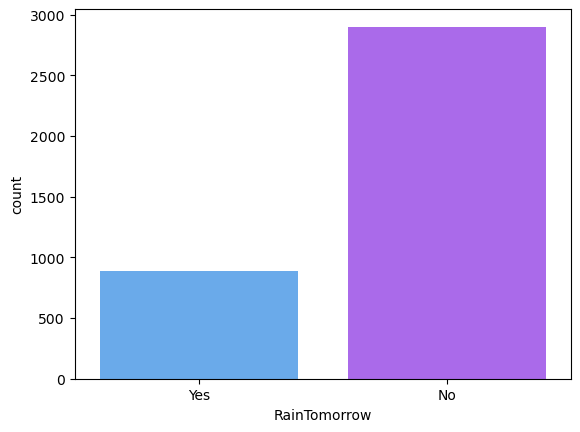

In [43]:
print(df['RainTomorrow'].value_counts())
sns.countplot(df['RainTomorrow'],palette='cool')

In [44]:
df['RainTomorrow']=le.fit_transform(df['RainTomorrow'])

In [45]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1,1
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1,1
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1,0
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0,0
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1,0
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0,1
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1,0
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0,0


Now the complete data set is in numeric formate hence we can apply logistic regression initially and for rainfall we will apply Linear Regression saperately

In [46]:
df.describe()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
count,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,...,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000,3790.000000
mean,2.629024,14.071029,24.733483,2.451768,5.292533,7.852744,7.245910,41.203958,7.415040,7.663325,...,63.683641,49.435620,1017.488047,1015.037836,4.116623,4.214776,18.963536,23.226201,0.234565,0.234565
std,1.500454,5.161176,6.068364,7.772025,3.642341,3.816696,4.894959,13.857829,4.796248,4.682656,...,16.273443,17.673797,6.560724,6.485755,2.773039,2.647355,5.528374,5.929694,0.423782,0.423782
min,0.000000,-0.700000,10.800000,0.000000,0.000000,0.000000,0.000000,13.000000,0.000000,0.000000,...,11.000000,6.000000,992.900000,990.800000,0.000000,0.000000,4.500000,9.400000,0.000000,0.000000
25%,1.000000,10.200000,20.300000,0.000000,2.800000,5.200000,3.000000,31.000000,3.000000,3.000000,...,53.000000,38.000000,1013.100000,1010.400000,1.000000,1.000000,14.900000,19.100000,0.000000,0.000000
50%,3.000000,14.000000,24.100000,0.000000,4.600000,8.900000,8.000000,39.000000,7.000000,8.000000,...,64.000000,49.000000,1017.400000,1015.050000,5.000000,5.000000,18.700000,22.700000,0.000000,0.000000
75%,4.000000,17.900000,29.200000,0.800000,7.000000,10.800000,12.000000,50.000000,12.000000,12.000000,...,75.000000,61.000000,1021.700000,1019.300000,7.000000,7.000000,23.200000,27.300000,0.000000,0.000000
max,5.000000,28.500000,43.600000,168.400000,37.000000,13.900000,15.000000,102.000000,15.000000,15.000000,...,99.000000,98.000000,1039.000000,1035.600000,8.000000,8.000000,39.400000,42.400000,1.000000,1.000000


Observations :- Standard Deviation is high in "WindGustSpeed","Humidity9am","Humidity3pm", hence there is the possibilities of Outliers in this columns

There is a high difference in 75% and max value hence there is a possibility of outliers in "Rainfall", "Evaporation","WindGustSpeed", "Humidity3pm","Humidity9am"columns

In [47]:
dfcor=df.corr()
dfcor

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Location,1.000000,-0.105139,0.040452,-0.057983,0.229907,0.053642,0.007825,0.390821,-0.337265,0.205982,...,-0.098033,-0.231376,-0.047894,-0.012500,0.040150,0.007573,-0.100164,0.039780,-0.031628,-0.020422
MinTemp,-0.105139,1.000000,0.740095,0.071315,0.498337,0.080572,-0.195861,0.135500,-0.110994,-0.136629,...,-0.078824,0.044881,-0.475074,-0.485264,0.124513,0.038071,0.861185,0.713084,-0.005773,0.056973
MaxTemp,0.040452,0.740095,1.000000,-0.120673,0.595026,0.517246,-0.308394,0.122229,-0.301630,-0.171932,...,-0.416987,-0.426143,-0.354381,-0.453176,-0.311638,-0.309302,0.890487,0.977768,-0.286305,-0.196455
Rainfall,-0.057983,0.071315,-0.120673,1.000000,-0.064387,-0.237101,0.108397,0.073402,0.131331,0.064068,...,0.304251,0.267475,-0.120569,-0.067936,0.221206,0.191268,-0.050368,-0.126175,0.558509,0.284318
Evaporation,0.229907,0.498337,0.595026,-0.064387,1.000000,0.348017,-0.166428,0.258328,-0.144382,-0.074433,...,-0.399978,-0.316077,-0.277451,-0.298626,-0.141269,-0.190743,0.567189,0.581462,-0.206677,-0.110534
Sunshine,0.053642,0.080572,0.517246,-0.237101,0.348017,1.000000,-0.140928,-0.013350,-0.106848,-0.079320,...,-0.510185,-0.622432,0.019715,-0.057406,-0.701603,-0.720530,0.348258,0.541263,-0.336214,-0.481861
WindGustDir,0.007825,-0.195861,-0.308394,0.108397,-0.166428,-0.140928,1.000000,-0.070092,0.465693,0.565552,...,0.150147,0.186878,-0.100622,0.008982,0.141223,0.112562,-0.220771,-0.327850,0.207177,0.087582
WindGustSpeed,0.390821,0.135500,0.122229,0.073402,0.258328,-0.013350,-0.070092,1.000000,-0.256343,0.038301,...,-0.246922,-0.146193,-0.359885,-0.328083,0.054118,0.124275,0.094809,0.084074,0.072295,0.220913
WindDir9am,-0.337265,-0.110994,-0.301630,0.131331,-0.144382,-0.106848,0.465693,-0.256343,1.000000,0.250448,...,0.186306,0.253557,0.025185,0.122167,0.130006,0.063649,-0.183475,-0.308404,0.216458,0.051553
WindDir3pm,0.205982,-0.136629,-0.171932,0.064068,-0.074433,-0.079320,0.565552,0.038301,0.250448,1.000000,...,0.023649,0.039202,-0.143845,-0.042418,0.106336,0.071961,-0.147086,-0.191359,0.141682,0.042865


<AxesSubplot:>

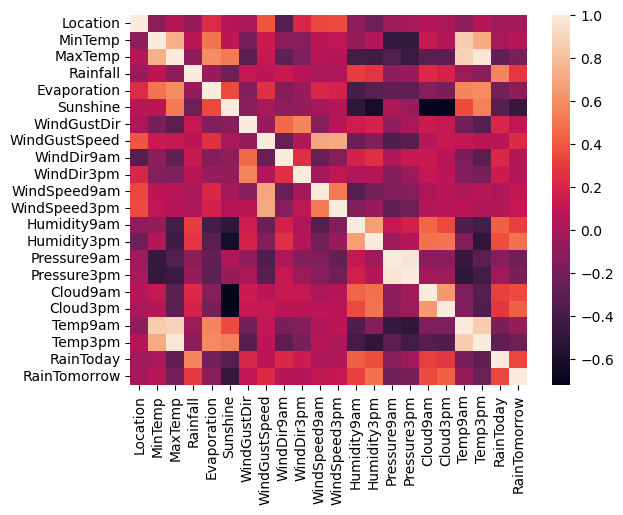

In [48]:
sns.heatmap(dfcor)

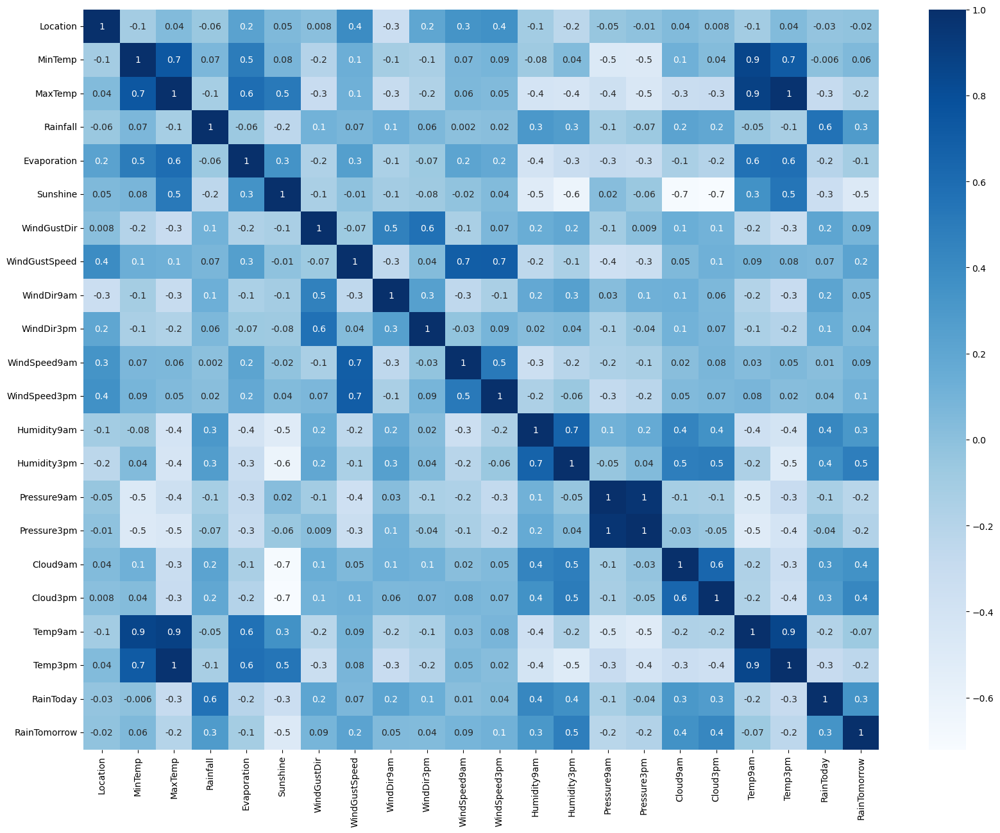

In [49]:
plt.figure(figsize=(20,15))
sns.heatmap(dfcor,cmap='Blues',fmt=".1g",annot= True)
plt.yticks(rotation=0);
plt.show()

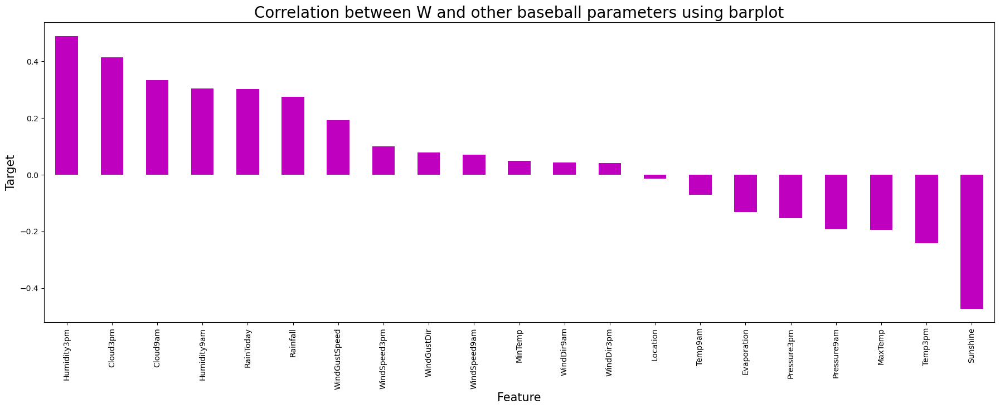

In [73]:
plt.figure(figsize=(22,7))
df.corr()['RainTomorrow'].sort_values(ascending = False).drop(['RainTomorrow']).plot(kind='bar',color="m")
plt.xlabel('Feature',fontsize =15)
plt.ylabel('Target',fontsize=15)
plt.title("Correlation between W and other baseball parameters using barplot",fontsize=20)
plt.show()

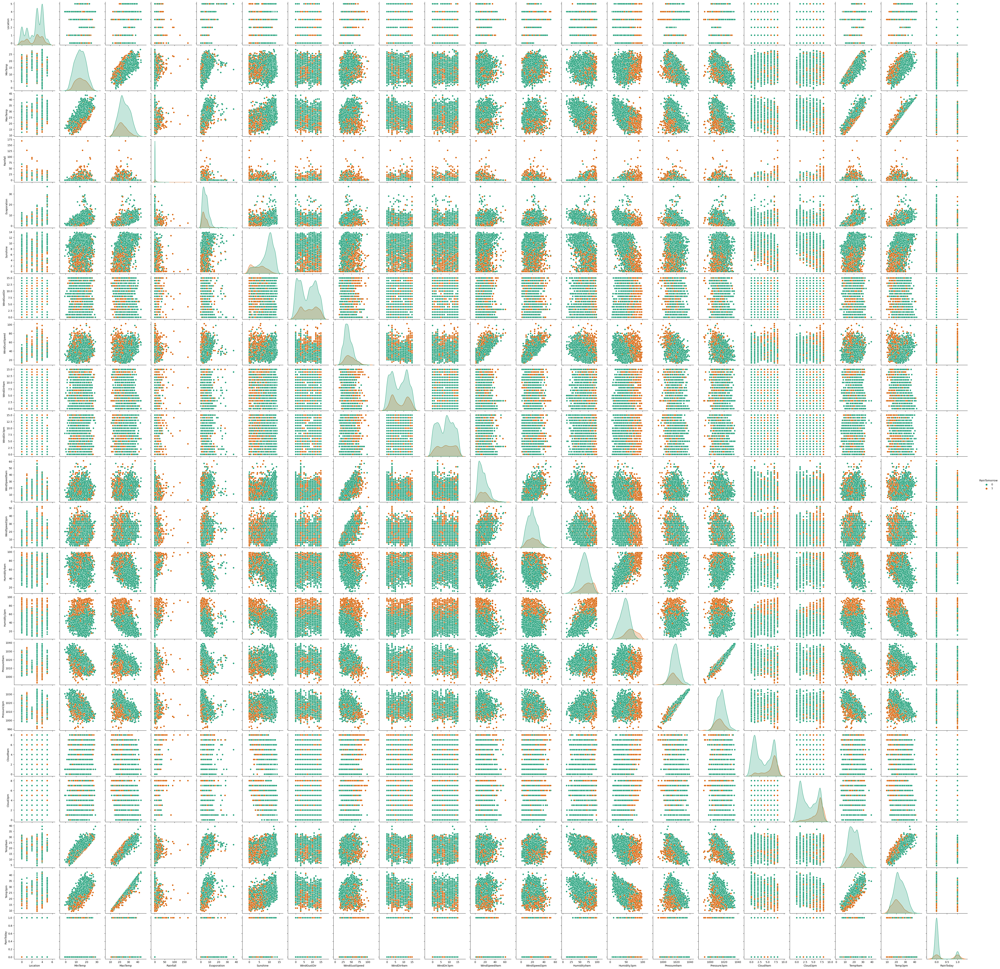

In [50]:
sns.pairplot(df,hue="RainTomorrow",palette="Dark2")
plt.show()

Location             AxesSubplot(0.125,0.77;0.168478x0.11)
MinTemp           AxesSubplot(0.327174,0.77;0.168478x0.11)
MaxTemp           AxesSubplot(0.529348,0.77;0.168478x0.11)
Rainfall          AxesSubplot(0.731522,0.77;0.168478x0.11)
Evaporation         AxesSubplot(0.125,0.638;0.168478x0.11)
Sunshine         AxesSubplot(0.327174,0.638;0.168478x0.11)
WindGustDir      AxesSubplot(0.529348,0.638;0.168478x0.11)
WindGustSpeed    AxesSubplot(0.731522,0.638;0.168478x0.11)
WindDir9am          AxesSubplot(0.125,0.506;0.168478x0.11)
WindDir3pm       AxesSubplot(0.327174,0.506;0.168478x0.11)
WindSpeed9am     AxesSubplot(0.529348,0.506;0.168478x0.11)
WindSpeed3pm     AxesSubplot(0.731522,0.506;0.168478x0.11)
Humidity9am         AxesSubplot(0.125,0.374;0.168478x0.11)
Humidity3pm      AxesSubplot(0.327174,0.374;0.168478x0.11)
Pressure9am      AxesSubplot(0.529348,0.374;0.168478x0.11)
Pressure3pm      AxesSubplot(0.731522,0.374;0.168478x0.11)
Cloud9am            AxesSubplot(0.125,0.242;0.168478x0.1

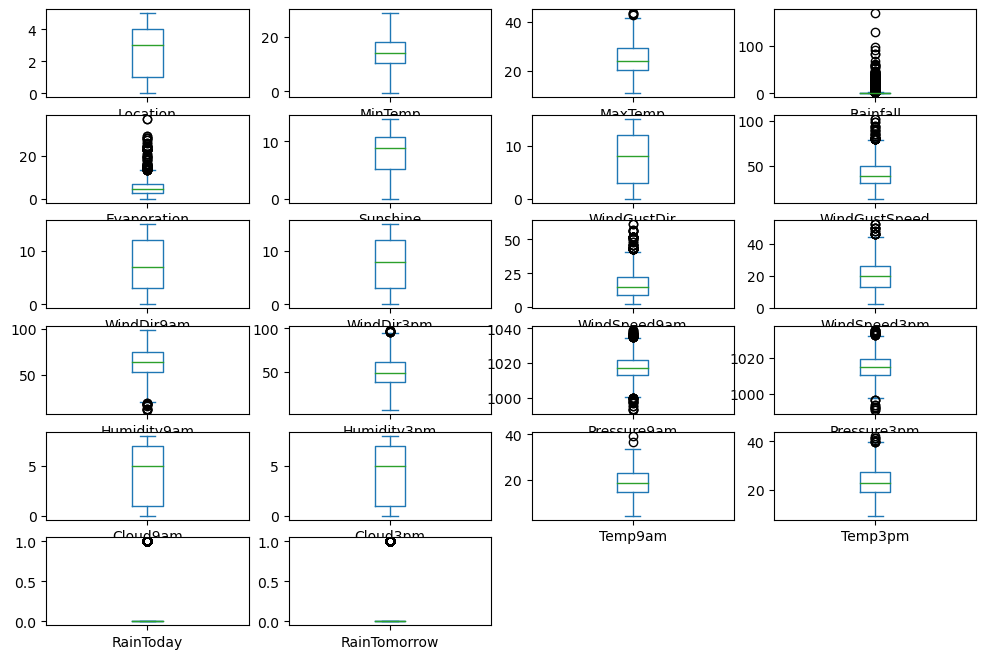

In [51]:
df.plot(kind='box',subplots=True,layout=(6,4),figsize=(12,8))

Observation - There are outliers in the columns 'Evaporation','Rainfall','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Humidity3pm','Pressure9am','Pressure3pm','Temp9am','Temp3am'

In [52]:
from scipy.stats import zscore
out_features=df[['Evaporation','Rainfall','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Humidity3pm','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]
z=np.abs(zscore(out_features))
z

,Evaporation,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm
907,0.908181,2.824377,0.447745,0.065386,0.218013,1.187143,0.597821,0.215241,0.441358,0.549323,0.467843
908,0.409827,0.559546,0.592087,0.065386,0.814249,1.310059,2.295473,0.489637,0.780608,0.368414,0.392349
909,0.684412,1.846382,1.602480,1.090652,1.273032,1.248601,0.880763,0.611591,0.780608,0.368414,0.214845
910,0.574578,0.315502,0.808600,0.985558,0.011379,0.265274,0.597821,0.215241,0.240893,0.784505,0.535309
911,0.413928,0.315502,0.634818,0.354992,1.709058,0.203817,1.050529,0.181109,0.345084,0.911141,0.450976
...,...,...,...,...,...,...,...,...,...,...,...
8381,0.354910,0.070548,0.159062,0.565180,0.218013,0.142359,0.194416,0.943320,1.100686,1.924231,1.715964
8382,0.194260,0.315502,0.923502,0.354992,0.814249,0.142359,2.465239,1.080518,1.270311,2.032776,0.332911
8383,0.249177,2.309643,0.303403,0.354992,0.011379,0.511106,0.314879,1.156740,1.362833,1.906140,1.479833
8384,0.135242,0.315502,0.303403,0.380669,0.814249,0.103473,0.484645,0.973809,1.254890,1.743322,1.395500


In [53]:
threshold=3
print(np.where(z>3))

(array([  26,   39,   41,   67,   88,  252,  253,  311,  312,  402,  403,
        456,  457,  458,  517,  518,  536,  548,  557,  564,  564,  567,
        571,  574,  578,  582,  583,  586,  587,  589,  592,  596,  599,
        603,  606,  610,  613,  617,  620,  624,  631,  647,  654,  654,
        657,  661,  664,  668,  672,  673,  676,  677,  679,  682,  686,
        689,  693,  696,  700,  703,  707,  710,  714,  721,  734,  734,
        769,  771,  820,  821,  840,  851,  858,  873,  874,  875,  879,
        879,  931,  971,  976,  976,  991, 1007, 1025, 1025, 1029, 1041,
       1041, 1041, 1042, 1046, 1064, 1068, 1071, 1071, 1096, 1108, 1112,
       1124, 1135, 1149, 1224, 1224, 1227, 1237, 1238, 1238, 1239, 1239,
       1239, 1247, 1264, 1265, 1273, 1286, 1288, 1289, 1289, 1297, 1297,
       1332, 1334, 1383, 1384, 1403, 1414, 1421, 1436, 1437, 1438, 1442,
       1442, 1494, 1534, 1539, 1539, 1554, 1570, 1588, 1588, 1592, 1604,
       1604, 1604, 1605, 1609, 1627, 1631, 1634, 1

In [54]:
df_new=df[(z<3).all(axis=1)]
df_new

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1,1
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1,1
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1,0
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0,0
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1,0
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0,1
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1,0
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0,0


In [55]:
df_new.shape

(3592, 23)

In [56]:
df=df_new
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1,1
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1,1
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1,0
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0,0
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1,0
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0,1
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1,0
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0,0


Checking for Skewness

In [57]:
df.skew()

Location        -0.509100
MinTemp          0.060683
MaxTemp          0.211684
Rainfall         3.272391
Evaporation      0.752532
Sunshine        -0.628099
WindGustDir     -0.000353
WindGustSpeed    0.516997
WindDir9am       0.014646
WindDir3pm      -0.066476
WindSpeed9am     0.657181
WindSpeed3pm     0.266483
Humidity9am     -0.175737
Humidity3pm      0.177962
Pressure9am      0.092789
Pressure3pm      0.146872
Cloud9am        -0.101846
Cloud3pm        -0.126713
Temp9am          0.015724
Temp3pm          0.219794
RainToday        1.347021
RainTomorrow     1.358779
dtype: float64

In [58]:
df.corr()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Location,1.000000,-0.114511,0.030005,-0.021795,0.169473,0.041038,0.012847,0.415723,-0.351450,0.225758,...,-0.095667,-0.230755,-0.041960,-0.004115,0.051806,0.018256,-0.115269,0.029941,-0.017465,-0.013648
MinTemp,-0.114511,1.000000,0.742600,0.030604,0.562068,0.088706,-0.201798,0.138669,-0.119419,-0.139949,...,-0.082644,0.046014,-0.491114,-0.503698,0.122496,0.034411,0.862433,0.716892,-0.021268,0.048613
MaxTemp,0.030005,0.742600,1.000000,-0.185191,0.679701,0.522923,-0.317481,0.133973,-0.308385,-0.175063,...,-0.414609,-0.418879,-0.380717,-0.483275,-0.306369,-0.305086,0.890848,0.979121,-0.286447,-0.194941
Rainfall,-0.021795,0.030604,-0.185191,1.000000,-0.150803,-0.251881,0.160564,0.068462,0.159006,0.102817,...,0.344620,0.277649,-0.110146,-0.036358,0.236812,0.201586,-0.107365,-0.189607,0.728329,0.273947
Evaporation,0.169473,0.562068,0.679701,-0.150803,1.000000,0.412692,-0.183815,0.316018,-0.191507,-0.049748,...,-0.516136,-0.378578,-0.341847,-0.367037,-0.183934,-0.223084,0.644524,0.659068,-0.244736,-0.131955
Sunshine,0.041038,0.088706,0.522923,-0.251881,0.412692,1.000000,-0.139514,0.018470,-0.108445,-0.078244,...,-0.512756,-0.616325,-0.014230,-0.093602,-0.695419,-0.714747,0.357285,0.545114,-0.319208,-0.472380
WindGustDir,0.012847,-0.201798,-0.317481,0.160564,-0.183815,-0.139514,1.000000,-0.082237,0.469988,0.565783,...,0.147521,0.186364,-0.086049,0.025589,0.140886,0.109722,-0.224968,-0.334681,0.198185,0.077875
WindGustSpeed,0.415723,0.138669,0.133973,0.068462,0.316018,0.018470,-0.082237,1.000000,-0.265532,0.042253,...,-0.257441,-0.168760,-0.325133,-0.291189,0.037553,0.099898,0.097215,0.102470,0.061442,0.192026
WindDir9am,-0.351450,-0.119419,-0.308385,0.159006,-0.191507,-0.108445,0.469988,-0.265532,1.000000,0.244317,...,0.173763,0.248917,0.031376,0.127232,0.121503,0.065575,-0.186655,-0.316436,0.200974,0.042474
WindDir3pm,0.225758,-0.139949,-0.175063,0.102817,-0.049748,-0.078244,0.565783,0.042253,0.244317,1.000000,...,0.024199,0.036621,-0.141208,-0.040796,0.107939,0.073950,-0.149706,-0.190996,0.138492,0.040855


In [59]:
x=df.drop("RainTomorrow", axis = 1)
y=df["RainTomorrow"]

In [60]:
x

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,22.0,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,13.0,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,9.0,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,20.0,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,35.0,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,22.0,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,13.0,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,20.0,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,13.0,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0


In [61]:
y

907     1
908     1
909     0
910     0
911     1
       ..
8381    0
8382    1
8383    0
8384    0
8385    0
Name: RainTomorrow, Length: 3592, dtype: int32

In [63]:
x

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
907,2009-03-10,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,...,22.0,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1
908,2009-03-11,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,...,13.0,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1
909,2009-03-12,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,...,9.0,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1
910,2009-03-13,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,...,20.0,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0
911,2009-03-14,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,...,35.0,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2012-11-06,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,...,22.0,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1
8382,2012-11-07,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,...,13.0,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0
8383,2012-11-08,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,...,20.0,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1
8384,2012-11-09,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,...,13.0,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0


In [68]:
x.drop(['Date'], axis=1, inplace= True)

In [69]:
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
907,1,19.8,27.1,24.4,8.6,9.0,2,35.0,12,2,...,22.0,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1
908,1,18.7,25.6,6.8,3.8,3.4,0,33.0,12,8,...,13.0,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1
909,1,16.5,25.5,16.8,2.8,6.1,15,19.0,15,2,...,9.0,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1
910,1,18.5,26.9,0.0,3.2,11.0,1,30.0,12,1,...,20.0,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0
911,1,18.2,28.2,0.0,6.8,9.0,5,50.0,6,4,...,35.0,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2,25.2,34.5,3.0,4.0,9.2,5,39.0,3,5,...,22.0,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1
8382,2,26.2,33.3,0.0,6.0,5.9,3,54.0,1,0,...,13.0,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0
8383,2,24.9,32.8,20.4,6.2,8.7,14,37.0,5,7,...,20.0,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1
8384,2,25.5,33.1,0.0,4.8,7.1,10,37.0,0,15,...,13.0,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0


In [70]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,-1.068275,1.126807,0.401051,5.566874,1.195893,0.283053,-1.070895,-0.419725,0.952076,-1.217468,...,0.260505,1.225885,0.622374,0.193961,0.428555,0.701456,0.700985,0.562877,0.475482,1.878732
1,-1.068275,0.913934,0.151511,1.263248,-0.414811,-1.200058,-1.479202,-0.573402,0.952076,0.064102,...,-0.804711,1.351313,2.342572,0.477848,0.777823,-0.022056,1.080136,0.381234,-0.392352,1.878732
2,-1.068275,0.488188,0.134875,3.708490,-0.750375,-0.484987,1.583097,-1.649143,1.576441,-1.217468,...,-1.278140,1.288599,0.909074,0.604020,0.777823,0.339700,1.080136,0.381234,0.220236,1.878732
3,-1.068275,0.875229,0.367779,-0.399517,-0.616149,0.812735,-1.275048,-0.803918,0.952076,-1.431063,...,0.023790,0.285180,0.622374,0.193961,0.222169,-0.745568,0.321835,0.799014,0.543547,-0.532274
4,-1.068275,0.817173,0.584046,-0.399517,0.591879,0.283053,-0.458435,0.732855,-0.296655,-0.790278,...,1.799149,0.222466,1.081094,-0.216099,-0.381113,-1.107323,-1.194768,0.926164,0.458465,-0.532274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3587,-0.400696,2.171819,1.632111,0.334056,-0.347699,0.336021,-0.458435,-0.112370,-0.921020,-0.576683,...,0.260505,0.159752,-0.180385,-1.004675,-1.159029,1.063212,1.080136,1.943367,1.734690,1.878732
3588,-0.400696,2.365340,1.432480,-0.399517,0.323428,-0.537955,-0.866742,1.040209,-1.337264,-1.644658,...,-0.804711,0.159752,2.514592,-1.146619,-1.333663,-0.022056,1.459287,2.052353,0.339351,-0.532274
3589,-0.400696,2.113763,1.349300,4.588777,0.390541,0.203600,1.378944,-0.266047,-0.504776,-0.149493,...,0.023790,0.536034,0.335675,-1.225476,-1.428918,-0.022056,0.700985,1.925203,1.496462,1.878732
3590,-0.400696,2.229876,1.399208,-0.399517,-0.079248,-0.220146,0.562331,-0.266047,-1.545385,1.559268,...,-0.804711,-0.091102,0.507695,-1.036218,-1.317787,1.063212,1.080136,1.761724,1.411380,-0.532274


In [71]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(x.values,i)
                  for i in range(len(x.columns))]
vif["Features"]=x.columns
vif

,VIF values,Features
0,1.887192,Location
1,7.868656,MinTemp
2,36.768617,MaxTemp
3,2.188242,Rainfall
4,2.638570,Evaporation
5,3.855127,Sunshine
6,1.955373,WindGustDir
7,3.379919,WindGustSpeed
8,1.789584,WindDir9am
9,1.668157,WindDir3pm


In [72]:
y.value_counts()

0    2805
1     787
Name: RainTomorrow, dtype: int64

In [74]:
x.drop("Temp3pm", axis=1, inplace= True)

In [75]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(x.values,i)
                  for i in range(len(x.columns))]
vif["Features"]=x.columns
vif

,VIF values,Features
0,1.880282,Location
1,7.711732,MinTemp
2,13.241687,MaxTemp
3,2.185654,Rainfall
4,2.637310,Evaporation
5,3.854248,Sunshine
6,1.950781,WindGustDir
7,3.330689,WindGustSpeed
8,1.789582,WindDir9am
9,1.667776,WindDir3pm


In [76]:
x.drop("Pressure9am", axis=1, inplace= True)

In [77]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(x.values,i)
                  for i in range(len(x.columns))]
vif["Features"]=x.columns
vif

,VIF values,Features
0,1.803276,Location
1,7.580859,MinTemp
2,11.786784,MaxTemp
3,2.184200,Rainfall
4,2.615961,Evaporation
5,3.831366,Sunshine
6,1.928724,WindGustDir
7,3.318106,WindGustSpeed
8,1.725224,WindDir9am
9,1.623207,WindDir3pm


In [78]:
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score

In [79]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier 
from sklearn.metrics import accuracy_score
maxAccu = 0 
maxRS = 0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=i)
    RFR =RandomForestClassifier()
    RFR.fit(x_train,y_train)
    pred=RFR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
        
print("Best accuracy is",maxAccu,"at random_state",maxRS)


Best accuracy is 0.9267161410018553 at random_state 52


Observation- Accuracy of the model is 92.675

In [80]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=maxRS)

In [81]:
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score

In [82]:
RFC= RandomForestClassifier()
RFC.fit(x_train,y_train)
predRFC = RFC.predict(x_test)
print(accuracy_score(y_test,predRFC))
print(confusion_matrix(y_test,predRFC))
print(classification_report(y_test,predRFC))

0.9202226345083488
[[828  31]
 [ 55 164]]
              precision    recall  f1-score   support

           0       0.94      0.96      0.95       859
           1       0.84      0.75      0.79       219

    accuracy                           0.92      1078
   macro avg       0.89      0.86      0.87      1078
weighted avg       0.92      0.92      0.92      1078



In [83]:
LR= LogisticRegression()
LR.fit(x_train,y_train)
predLR=LR.predict(x_test)
print(accuracy_score(y_test,predLR))
print(confusion_matrix(y_test,predLR))
print(classification_report(y_test,predLR))

0.87291280148423
[[800  59]
 [ 78 141]]
              precision    recall  f1-score   support

           0       0.91      0.93      0.92       859
           1       0.70      0.64      0.67       219

    accuracy                           0.87      1078
   macro avg       0.81      0.79      0.80      1078
weighted avg       0.87      0.87      0.87      1078



In [84]:
svc= SVC()
svc.fit(x_train,y_train)
predsvc=svc.predict(x_test)
print(accuracy_score(y_test,predsvc))
print(confusion_matrix(y_test,predsvc))
print(classification_report(y_test,predsvc))

0.8896103896103896
[[816  43]
 [ 76 143]]
              precision    recall  f1-score   support

           0       0.91      0.95      0.93       859
           1       0.77      0.65      0.71       219

    accuracy                           0.89      1078
   macro avg       0.84      0.80      0.82      1078
weighted avg       0.89      0.89      0.89      1078



In [85]:
GB= GradientBoostingClassifier()
GB.fit(x_train,y_train)
predGB=GB.predict(x_test)
print(accuracy_score(y_test,predGB))
print(confusion_matrix(y_test,predGB))
print(classification_report(y_test,predGB))

0.8923933209647495
[[813  46]
 [ 70 149]]
              precision    recall  f1-score   support

           0       0.92      0.95      0.93       859
           1       0.76      0.68      0.72       219

    accuracy                           0.89      1078
   macro avg       0.84      0.81      0.83      1078
weighted avg       0.89      0.89      0.89      1078



In [86]:
from sklearn.model_selection import cross_val_score

In [87]:
score=cross_val_score(RFC,x,y)
print(score)
print(score.mean())
print("The difference between accuracy score and cross validation score is - ",accuracy_score(y_test,predRFC)- score.mean())

[0.72878999 0.89986092 0.43314763 0.8718663  0.86072423]
0.7588778131186537
The difference between accuracy score and cross validation score is -  0.1613448213896952


In [88]:
score=cross_val_score(LR,x,y)
print(score)
print(score.mean())
print("The difference between accuracy score and cross validation score is - ",accuracy_score(y_test,predLR)- score.mean())

[0.8178025  0.79972184 0.85236769 0.87047354 0.86490251]
0.8410536143901503
The difference between accuracy score and cross validation score is -  0.031859187094079755


In [89]:
score=cross_val_score(svc,x,y)
print(score)
print(score.mean())
print("The difference between accuracy score and cross validation score is - ",accuracy_score(y_test,predRFC)- score.mean())

[0.82475661 0.84144645 0.72284123 0.86211699 0.87604457]
0.8254411690641209
The difference between accuracy score and cross validation score is -  0.09478146544422794


In [90]:
score=cross_val_score(GB,x,y)
print(score)
print(score.mean())
print("The difference between accuracy score and cross validation score is - ",accuracy_score(y_test,predRFC)- score.mean())

[0.67872045 0.84283727 0.36072423 0.85933148 0.86350975]
0.7210246357328539
The difference between accuracy score and cross validation score is -  0.19919799877549493


# Result: We will consider Random Forest Classifier because the accuracy is 92.02%

Now for Rainfall prediction

In [91]:
df.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [92]:
x=df.drop("Rainfall", axis = 1)
y=df["Rainfall"]

In [93]:
x

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
907,1,19.8,27.1,8.6,9.0,2,35.0,12,2,17.0,...,83.0,60.0,1018.9,1017.9,6.0,6.0,22.0,26.0,1,1
908,1,18.7,25.6,3.8,3.4,0,33.0,12,8,17.0,...,85.0,90.0,1020.7,1020.1,4.0,7.0,21.0,20.9,1,1
909,1,16.5,25.5,2.8,6.1,15,19.0,15,2,6.0,...,84.0,65.0,1021.5,1020.1,5.0,7.0,21.0,24.5,1,0
910,1,18.5,26.9,3.2,11.0,1,30.0,12,1,7.0,...,68.0,60.0,1018.9,1016.6,2.0,5.0,23.3,26.4,0,0
911,1,18.2,28.2,6.8,9.0,5,50.0,6,4,13.0,...,67.0,68.0,1016.3,1012.8,1.0,1.0,24.0,25.9,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8381,2,25.2,34.5,4.0,9.2,5,39.0,3,5,11.0,...,66.0,46.0,1011.3,1007.9,7.0,7.0,29.6,33.4,1,0
8382,2,26.2,33.3,6.0,5.9,3,54.0,1,0,13.0,...,66.0,93.0,1010.4,1006.8,4.0,8.0,30.2,25.2,0,1
8383,2,24.9,32.8,6.2,8.7,14,37.0,5,7,13.0,...,72.0,55.0,1009.9,1006.2,4.0,6.0,29.5,32.0,1,0
8384,2,25.5,33.1,4.8,7.1,10,37.0,0,15,20.0,...,62.0,58.0,1011.1,1006.9,7.0,7.0,28.6,31.5,0,0


In [94]:
y

907     24.4
908      6.8
909     16.8
910      0.0
911      0.0
        ... 
8381     3.0
8382     0.0
8383    20.4
8384     0.0
8385     0.0
Name: Rainfall, Length: 3592, dtype: float64

In [96]:
y.value_counts()

0.0     2473
0.2      151
0.4       77
0.6       43
1.2       42
        ... 
14.2       1
23.8       1
18.2       1
20.2       1
20.4       1
Name: Rainfall, Length: 120, dtype: int64

In [97]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,-1.068275,1.126807,0.401051,1.195893,0.283053,-1.070895,-0.419725,0.952076,-1.217468,0.118841,...,1.225885,0.622374,0.193961,0.428555,0.701456,0.700985,0.562877,0.475482,1.878732,1.887900
1,-1.068275,0.913934,0.151511,-0.414811,-1.200058,-1.479202,-0.573402,0.952076,0.064102,0.118841,...,1.351313,2.342572,0.477848,0.777823,-0.022056,1.080136,0.381234,-0.392352,1.878732,1.887900
2,-1.068275,0.488188,0.134875,-0.750375,-0.484987,1.583097,-1.649143,1.576441,-1.217468,-1.119465,...,1.288599,0.909074,0.604020,0.777823,0.339700,1.080136,0.381234,0.220236,1.878732,-0.529689
3,-1.068275,0.875229,0.367779,-0.616149,0.812735,-1.275048,-0.803918,0.952076,-1.431063,-1.006892,...,0.285180,0.622374,0.193961,0.222169,-0.745568,0.321835,0.799014,0.543547,-0.532274,-0.529689
4,-1.068275,0.817173,0.584046,0.591879,0.283053,-0.458435,0.732855,-0.296655,-0.790278,-0.331452,...,0.222466,1.081094,-0.216099,-0.381113,-1.107323,-1.194768,0.926164,0.458465,-0.532274,1.887900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3587,-0.400696,2.171819,1.632111,-0.347699,0.336021,-0.458435,-0.112370,-0.921020,-0.576683,-0.556599,...,0.159752,-0.180385,-1.004675,-1.159029,1.063212,1.080136,1.943367,1.734690,1.878732,-0.529689
3588,-0.400696,2.365340,1.432480,0.323428,-0.537955,-0.866742,1.040209,-1.337264,-1.644658,-0.331452,...,0.159752,2.514592,-1.146619,-1.333663,-0.022056,1.459287,2.052353,0.339351,-0.532274,1.887900
3589,-0.400696,2.113763,1.349300,0.390541,0.203600,1.378944,-0.266047,-0.504776,-0.149493,-0.331452,...,0.536034,0.335675,-1.225476,-1.428918,-0.022056,0.700985,1.925203,1.496462,1.878732,-0.529689
3590,-0.400696,2.229876,1.399208,-0.079248,-0.220146,0.562331,-0.266047,-1.545385,1.559268,0.456561,...,-0.091102,0.507695,-1.036218,-1.317787,1.063212,1.080136,1.761724,1.411380,-0.532274,-0.529689


In [98]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(x.values,i)
                  for i in range(len(x.columns))]
vif["Features"]=x.columns
vif

,VIF values,Features
0,1.885914,Location
1,7.922552,MinTemp
2,36.762774,MaxTemp
3,2.640034,Evaporation
4,3.986915,Sunshine
5,1.953445,WindGustDir
6,3.497877,WindGustSpeed
7,1.789524,WindDir9am
8,1.668090,WindDir3pm
9,2.355003,WindSpeed9am


In [99]:
x.drop("MaxTemp", axis=1, inplace= True)

In [100]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(x.values,i)
                  for i in range(len(x.columns))]
vif["Features"]=x.columns
vif

,VIF values,Features
0,1.872480,Location
1,7.919691,MinTemp
2,2.618289,Evaporation
3,3.905358,Sunshine
4,1.953431,WindGustDir
5,3.433173,WindGustSpeed
6,1.788729,WindDir9am
7,1.665483,WindDir3pm
8,2.331584,WindSpeed9am
9,2.238319,WindSpeed3pm


In [101]:
x.drop("Pressure9am", axis=1, inplace= True)

In [102]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(x.values,i)
                  for i in range(len(x.columns))]
vif["Features"]=x.columns
vif

,VIF values,Features
0,1.792549,Location
1,7.745547,MinTemp
2,2.599173,Evaporation
3,3.893705,Sunshine
4,1.935587,WindGustDir
5,3.426206,WindGustSpeed
6,1.725964,WindDir9am
7,1.625195,WindDir3pm
8,2.325389,WindSpeed9am
9,2.237508,WindSpeed3pm


In [103]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression

In [104]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size= 0.33,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("maximum r2 score is ",maxAccu, "on Random_state",maxRS)

maximum r2 score is  0.571699793101563 on Random_state 66


In [105]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size =0.30,random_state=maxRS)

In [106]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import Lasso,Ridge

In [107]:
LR=LinearRegression()
LR.fit(x_train,y_train)
pred_LR=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('R2_score:', r2_score(y_test,pred_LR))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_LR))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_LR))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_LR)))

R2_score: 0.5787844736544241
R2_score on training data: 52.55900577256112
Mean Absolute Error :- 1.2590889263091025
Mean_Squared_Error :-  7.261326456879809
Root Mean Square Error:- 2.6946848529799934


In [108]:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('R2_score:', r2_score(y_test,pred_RFR))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_RFR))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_RFR))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_RFR)))

R2_score: 0.6528143130448222
R2_score on training data: 94.71747438833219
Mean Absolute Error :- 0.9133153988868274
Mean_Squared_Error :-  5.985127461966604
Root Mean Square Error:- 2.4464520150549864


In [109]:
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('R2_score:', r2_score(y_test,pred_GBR))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_GBR))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_GBR))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_GBR)))

R2_score: 0.5995438706196443
R2_score on training data: 74.62347275551473
Mean Absolute Error :- 1.0871342305395382
Mean_Squared_Error :-  6.903455606960683
Root Mean Square Error:- 2.627442788522841


In [110]:
lasso=Lasso()
lasso.fit(x_train,y_train)
pred_lasso=lasso.predict(x_test)
pred_train=lasso.predict(x_train)
print('R2_score:', r2_score(y_test,pred_lasso))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_lasso))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_lasso))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_lasso)))

R2_score: 0.4815694602665288
R2_score on training data: 45.521460971822336
Mean Absolute Error :- 1.4511702218375007
Mean_Squared_Error :-  8.937214225889308
Root Mean Square Error:- 2.9895173901299366


In [111]:
rd=Ridge()
rd.fit(x_train,y_train)
pred_rd=rd.predict(x_test)
pred_train=rd.predict(x_train)
print('R2_score:', r2_score(y_test,pred_rd))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_rd))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_rd))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_rd)))

R2_score: 0.578771992233314
R2_score on training data: 52.55899423392203
Mean Absolute Error :- 1.2589739871355787
Mean_Squared_Error :-  7.261541623861218
Root Mean Square Error:- 2.6947247770154967


In [112]:
from sklearn.tree import DecisionTreeRegressor
dtr=DecisionTreeRegressor()
dtr.fit(x_train,y_train)
pred_dtr=dtr.predict(x_test)
pred_train=dtr.predict(x_train)
print('R2_score:', r2_score(y_test,pred_dtr))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_dtr))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_dtr))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_dtr)))

R2_score: 0.2998436830484522
R2_score on training data: 100.0
Mean Absolute Error :- 1.153617810760668
Mean_Squared_Error :-  12.069981447124302
Root Mean Square Error:- 3.47418788310654


In [113]:
from sklearn.svm import SVR
svr=SVR()
svr.fit(x_train,y_train)
pred_svr=svr.predict(x_test)
pred_train=svr.predict(x_train)
print('R2_score:', r2_score(y_test,pred_svr))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_svr))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_svr))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_svr)))

R2_score: 0.4661003110706152
R2_score on training data: 46.489634859686646
Mean Absolute Error :- 1.080678942048947
Mean_Squared_Error :-  9.203886595011697
Root Mean Square Error:- 3.0337907961841566


In [114]:
from sklearn.ensemble import ExtraTreesRegressor
etr=ExtraTreesRegressor()
etr.fit(x_train,y_train)
pred_etr=etr.predict(x_test)
pred_train=etr.predict(x_train)
print('R2_score:', r2_score(y_test,pred_etr))
print('R2_score on training data:', r2_score(y_train,pred_train)*100)
print('Mean Absolute Error :-', mean_absolute_error(y_test,pred_etr))
print('Mean_Squared_Error :- ', mean_squared_error (y_test,pred_etr))
print('Root Mean Square Error:-', np.sqrt(mean_squared_error(y_test,pred_etr)))

R2_score: 0.6680993834856875
R2_score on training data: 100.0
Mean Absolute Error :- 0.8203896103896107
Mean_Squared_Error :-  5.721628423005566
Root Mean Square Error:- 2.3919925633257235


In [115]:
from sklearn.model_selection import cross_val_score

In [116]:
score=cross_val_score(LR,x,y,cv=5,scoring='r2')
print(score)
print(score.mean())
print("Difference between R2 score and cross validation is :- ",(r2_score(y_test,pred_LR)- score.mean())*100)

[0.53365658 0.47848541 0.50981393 0.55228518 0.5286128 ]
0.5205707798072761
Difference between R2 score and cross validation is :-  5.821369384714803


In [117]:
score1=cross_val_score(RFR,x,y,cv=5,scoring='r2')
print(score1)
print(score1.mean())
print("Difference between R2 score and cross validation is :- ",(r2_score(y_test,pred_RFR)- score.mean())*100)

[0.52785583 0.74693274 0.68974005 0.580739   0.55556776]
0.6201670758558003
Difference between R2 score and cross validation is :-  13.224353323754611


In [118]:
score2=cross_val_score(svr,x,y,cv=5,scoring='r2')
print(score2)
print(score2.mean())
print("Difference between R2 score and cross validation is :- ",(r2_score(y_test,pred_svr)- score.mean())*100)

[0.42807373 0.5277643  0.39605255 0.41722828 0.422183  ]
0.43826037135796714
Difference between R2 score and cross validation is :-  -5.447046873666084


In [119]:
score3=cross_val_score(etr,x,y,cv=5,scoring='r2')
print(score3)
print(score3.mean())
print("Difference between R2 score and cross validation is :- ",(r2_score(y_test,pred_etr)- score.mean())*100)

[0.5639543  0.82396828 0.71223025 0.55574675 0.55164118]
0.6415081546499983
Difference between R2 score and cross validation is :-  14.752860367841148


In [120]:
score4=cross_val_score(dtr,x,y,cv=5,scoring='r2')
print(score4)
print(score4.mean())
print("Difference between R2 score and cross validation is :- ",(r2_score(y_test,pred_dtr)- score.mean())*100)

[-0.11633429  0.69764484  0.44448092  0.30023176  0.35234265]
0.33567317696854826
Difference between R2 score and cross validation is :-  -22.072709675882386


In [121]:
score5=cross_val_score(GBR,x,y,cv=5,scoring='r2')
print(score5)
print(score5.mean())
print("Difference between R2 score and cross validation is :- ",(r2_score(y_test,pred_GBR)- score.mean())*100)

[0.53006578 0.56892804 0.60742074 0.54733341 0.55207227]
0.5611640508353869
Difference between R2 score and cross validation is :-  7.897309081236825


# Result: We will consider Extra Trees Regressor because the accuracy is 66.80%